# Introduction

The goal is to create some models that can forecast housing costs in Perth (located in Western Australia) utilising a collection of features that were abandoned and made available in the Perth Housing Dataset.

The notebook be divided into two sections: (I) the Exploratory Data Analysis (EDA) and (II) the Mechine Learning models to predict price.


In [1]:
##While attempting to achieve our objective of predicting the desired varaible price, 
##let's explore what we can discover about the dataset. 
##The separation is primarily made because the plots place a significant demand on the notebook's loading speed

## Libraries set up

import pandas as pd; import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly
from plotly.subplots import make_subplots
import os
from catboost import CatBoostClassifier,CatBoostRegressor
from sklearn.feature_selection import SelectKBest,f_regression
from xgboost import plot_importance,XGBClassifier,XGBRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import preprocessing
import seaborn as sns
import shap
from scipy import stats

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.figure_factory as ff
from sklearn.base import BaseEstimator,TransformerMixin

%matplotlib inline
cmap = sns.diverging_palette(220, 10, as_cmap=True)

import warnings
warnings.filterwarnings('ignore')


In [2]:

''' Various Helper Functions '''

'''Plot Correlation Matrix'''
def corrMat(df,id=False,figsize=(10,10)):
    
    corr_mat = df.corr().round(2)
    f, ax = plt.subplots(figsize=figsize)
    mask = np.triu(np.ones_like(corr_mat, dtype=np.bool))
    mask = mask[1:,:-1]
    corr = corr_mat.iloc[1:,:-1].copy()
    sns.heatmap(corr,mask=mask,vmin=-0.3,vmax=0.3,center=0, 
                cmap='Blues',square=False,lw=2,annot=True,cbar=False)

'''Plot Correlation to Target Variable only'''
def corrMat2(df,target='demand',figsize=(9,0.5),ret_id=False):
    
    corr_mat = df.corr().round(2);shape = corr_mat.shape[0]
    corr_mat = corr_mat.transpose()
    corr = corr_mat.loc[:, df.columns == target].transpose().copy()
    
    if(ret_id is False):
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(corr,vmin=-0.3,vmax=0.3,center=0, 
                     cmap=cmap,square=False,lw=2,annot=True,cbar=False)
        plt.title(f'Feature Correlation to {target}')
    
    if(ret_id):
        return corr
    
'''Correlation plot w/ Plotly'''
def plotlyoff_corr(corr,size=None):
    
    xcols = corr.columns.tolist();ycols = xcols
    if(size is None):
        width = 700; height = 500
    else:
        width = size[0]; height = size[1]
    
    layout = dict(
        width = width,height = height,
        yaxis= dict(tickangle=-30,side = 'left'),
        xaxis= dict(tickangle=-30,side = 'top'))
    fig = ff.create_annotated_heatmap(
        z=corr.values,x= xcols,y= ycols,
        colorscale='viridis',showscale=False)
    fig['layout'].update(layout)
    fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0})
    
    return py.iplot(fig)

''' Draw a Bivariate Seaborn Pairgrid /w KDE density w/ '''
def snsPairGrid(df):

    ''' Plots a Seaborn Pairgrid w/ KDE & scatter plot of df features'''
    g = sns.PairGrid(df,diag_sharey=False)
    g.fig.set_size_inches(14,13)
    g.map_diag(sns.kdeplot, lw=2) # draw kde approximation on the diagonal
    g.map_lower(sns.scatterplot,s=15,edgecolor="k",linewidth=1,alpha=0.4) # scattered plot on lower half
    g.map_lower(sns.kdeplot,cmap='plasma',n_levels=10) # kde approximation on lower half
    plt.tight_layout()

'''Basic Transformer'''
class transformer(BaseEstimator,TransformerMixin):
    
    def __init__(self,drop_nan=False,select_dtype=False,show_nan=False,title='Title',show_counts=False,figsize=None):
        self.drop_nan = drop_nan
        self.select_dtype = select_dtype
        self.show_nan = show_nan
        self.title = title
        self.show_counts = show_counts
        self.figsize = figsize
        
    # Apply Fit
    def fit(self,X,y=None):
        return self
        
    # Apply Some Transformation to the Feature Matrix
    def transform(self,X):
        
        # show NaN % in DataFrame
        if(self.show_nan):
            
            fig, ax = plt.subplots(figsize = self.figsize)
            nan_val = (X.isnull().sum()/len(X)*100).sort_values(ascending = False)
            cmap = sns.color_palette("plasma")
            for i in ['top', 'right', 'bottom', 'left']:
                ax.spines[i].set_color('black')
            ax.spines['top'].set_visible(True);ax.spines['right'].set_visible(False)
            ax.spines['bottom'].set_visible(False);ax.spines['left'].set_visible(False)
            sns.barplot(x=nan_val,y=nan_val.index, edgecolor='k',palette = 'rainbow')
            plt.title(self.title);ax.grid(ls='--',alpha = 0.9);plt.show()
            return
        
        ''' Plot df.value_counts '''
        if(self.show_counts):
        
            tdf = X.value_counts()
            cmap = sns.color_palette("plasma")
            fig, ax = plt.subplots(figsize = self.figsize)
            for i in ['top', 'right', 'bottom', 'left']:
                ax.spines[i].set_color('black')
            ax.spines['top'].set_visible(True);ax.spines['right'].set_visible(False)
            ax.spines['bottom'].set_visible(False);ax.spines['left'].set_visible(False)
            sns.barplot(tdf.index,tdf.values,edgecolor='k',palette = 'rainbow',ax=ax);
            plt.title(self.title);ax.grid(ls='--',alpha = 0.9);plt.show()
        
        ''' Drop All NAN values in DataFrame'''
        if(self.drop_nan):
            X = X.dropna(); print(X.shape) # drop NaN values in df
            return X
            
        ''' Split DataFrame into Numerical/Object features'''
        if(self.select_dtype):
            X1 = X.select_dtypes(include=['float64','int64'])     # return only numerical features from df
            X2 = X.select_dtypes(exclude=['float64','int64'])
            return X1,X2
        
        
def function(ldf,id=None):

    if(id is 'boxplot'):
        # 1. Univariate Boxplots
        fig, axs = plt.subplots(ncols=5, nrows=3, figsize=(14,4))
        index = 0
        axs = axs.flatten()
        for k,v in X.items():

            flierprops = dict(marker='o', mfc='k',ms=3,ls='none', mec='k')
            ax = sns.boxplot(x=k,data=ldf, orient='h',flierprops=flierprops,
                             ax=axs[index], width=.5)
            index += 1
        plt.tight_layout()

    elif(id is 'outiers'):
#       2. Define Outliers
        for k, v in ldf.items():
            q1 = v.quantile(0.25); q3 = v.quantile(0.75); irq = q3 - q1
            v_col = v[(v <= q1 - 1.5 * irq) | (v >= q3 + 1.5 * irq)]
            perc = np.shape(v_col)[0] * 100.0 / np.shape(ldf)[0]
            print("Column %s outliers = %.2f%%" % (k, perc))
    
    elif(id is 'histograms'):
        # 3. Histograms 
        fig, axs = plt.subplots(ncols=5, nrows=3, figsize=(14, 8))
        index = 0
        axs = axs.flatten()
        for k,v in ldf.items():
            sns.histplot(v,ax=axs[index],bins=20)
            index += 1
        plt.tight_layout()
        
    elif(id is 'correlation'):
        # 4. Correlation Matrix
        cmap = sns.diverging_palette(220, 10, as_cmap=True)
        # Bivariate Correlation Matrix
        def corrMat(df,id=False):

            corr_mat = df.corr().round(2)
            f, ax = plt.subplots(figsize=(9,7))
            mask = np.triu(np.ones_like(corr_mat, dtype=np.bool))
            mask = mask[1:,:-1]
            corr = corr_mat.iloc[1:,:-1].copy()
            sns.heatmap(corr,mask=mask,vmin=-0.3,vmax=0.3,center=0, 
                        cmap='Blues',square=False,lw=2,annot=True,cbar=False)

        corrMat(ldf)
        
''' Draw a Bivariate Seaborn Pairgrid /w KDE density w/ '''
def snsPairGrid(df):

    ''' Plots a Seaborn Pairgrid w/ KDE & scatter plot of df features'''
    g = sns.PairGrid(df,diag_sharey=False)
    g.fig.set_size_inches(14,13)
    g.map_diag(sns.kdeplot, lw=2) # draw kde approximation on the diagonal
    g.map_lower(sns.scatterplot,s=15,edgecolor="k",linewidth=1,alpha=0.4) # scattered plot on lower half
    g.map_lower(sns.kdeplot,cmap='plasma',n_levels=10) # kde approximation on lower half
    plt.tight_layout()
    
    
# Class to Visualise Things Only
class visualise(BaseEstimator,TransformerMixin):
    
    def __init__(self,vis_mean_AUD=None,model_name=None,target=None,eval_fi=False,vis_box=False,
                 vis_compare_mean_AUD=False,vis_compare_bar=False,top_scat=50,top_bar=None,
                 option=False):
        self.vis_mean_AUD = vis_mean_AUD # [T/F] trigger for mean AUD visualisation 
        self.model_name = model_name     # define which model plot in vis_mean_AUD
        self.target = target             # target varable [str]
        self.vis_box = vis_box # boxplots for univariate analysis
        self.vis_compare_mean_AUD = vis_compare_mean_AUD
        self.top_scat = top_scat # export only top n number of suburbs for scatter matrix
        self.top_bar = top_bar   # show only top cases for bar sort
        self.vis_compare_bar = vis_compare_bar # compare two bar plots (general)
        self.option = option

    @staticmethod 
    def corrMat2(df,target='demand',figsize=(9,0.5),ret_id=False):

        corr_mat = df.corr().round(2);shape = corr_mat.shape[0]
        corr_mat = corr_mat.transpose()
        corr = corr_mat.loc[:, df.columns == target].transpose().copy()

        if(ret_id is False):
            f, ax = plt.subplots(figsize=figsize)
            sns.heatmap(corr,vmin=-0.3,vmax=0.3,center=0, 
                         cmap=cmap,square=False,lw=2,annot=True,cbar=False)
            plt.title(f'Feature Correlation to {target}')

        if(ret_id):
            return corr
        
    def fit(self):
        return self
    
    # X -> Numerical (feature matrix + target variable)
    def transform(self,X):
        
        if(self.option is 'histogram'):
            vdf_perth1_num,_ = transformer(select_dtype=True).transform(X=X)
            vdf_perth1_num.hist(bins=60, figsize=(20,15));plt.show()
        
        ''' show suburb based mean price prediction/price '''
        if(self.vis_mean_AUD is not None):
            
            # Combine Numerical & Object Features
            if(self.vis_mean_AUD is 'error'):
                tdfx = X.groupby(['suburb']).mean().sort_values(by=self.model_name+'_error',ascending=False)
                
                if(self.top_bar is not None):
                    dfx = X.groupby(['suburb']).mean().sort_values(by=self.model_name+'_error',ascending=False)[:self.top_bar]
                else:
                    dfx = tdfx
                    
                fig = px.bar(dfx,x=dfx.index, y=[self.model_name+'_error'],template='plotly_white',height=400)
                fig.update_layout(barmode="group",title='Suburb Based Mean Error |(y_pred-y_target)|',showlegend=True)
                
            elif(self.vis_mean_AUD is 'value'):
                tdfx = X.groupby(['suburb']).mean().sort_values(by=self.model_name+'_error',ascending=False)                
                if(self.top_bar is not None):
                    dfx = X.groupby(['suburb']).mean().sort_values(by=self.model_name+'_error',ascending=False)[:self.top_bar]
                else:
                    dfx = tdfx
                
                fig = px.bar(dfx,x=dfx.index, y=[self.model_name,self.target],template='plotly_white',height=400)
                fig.update_layout(barmode="group",title='Suburb-Based Mean Prediction/Target Variable',showlegend=True)

            # Used for Scatter Matrix Import 
            fig.show() # stack/overlay/group
            tdfx.loc[:,'group_id2'] = 0
            tdfx.loc[:self.top_scat,'group_id2'] = 1
            
            return tdfx
        
        ''' Compare Mean Groupby Suburb Error Bars '''
        # X -> List of Pandas DataFrames
        if(self.vis_compare_mean_AUD):
            
            dfx1 = X[0].groupby(['suburb']).mean().sort_values(by=self.model_name+'_error',ascending=False)
            dfx2 = X[1].groupby(['suburb']).mean().sort_values(by=self.model_name+'_error',ascending=False)
            dfx1.rename(columns = {self.model_name+'_error':'A'}, inplace = True)
            dfx2.rename(columns = {self.model_name+'_error':'B'}, inplace = True)
            dfx_all = pd.concat([dfx1['A'],dfx2['B']],axis=1)               
            fig = px.bar(dfx_all,x=dfx_all.index, y=['A','B'],template='plotly_white',height=400)
            fig.update_layout(barmode="group",title='Suburb Based Mean Error |(y_pred-y_target)|',showlegend=True)
            fig.show()
            
        ''' Compare Two Error Bars (general)'''
        # X -> List of Pandas DataFrames
        if(self.vis_compare_bar):
            
            X[0].rename(columns = {self.model_name+'_error':'A'}, inplace = True)
            X[1].rename(columns = {self.model_name+'_error':'B'}, inplace = True)
            dfx_all = pd.concat([dfx1['A'],dfx2['B']],axis=1)               
            fig = px.bar(dfx_all,x=dfx_all.index, y=['A','B'],template='plotly_white',height=400)
            fig.update_layout(barmode="group",title='Suburb Based Mean Error |(y_pred-y_target)|',showlegend=True)
            fig.show()
            
        ''' Plot Univariate Boxplots for Data Distribution '''
        if(self.vis_box):
            
            lX,_ = transformer(select_dtype=True).transform(X=X)
            fig,axs = plt.subplots(ncols=5,nrows=3,figsize=(14,4))
            index = 0
            axs = axs.flatten()
            for k,v in lX.items():
                flierprops = dict(marker='o',mfc='k',ls='none',mec='k')
                ax = sns.boxplot(x=k,data=lX,orient='h',flierprops=flierprops,
                                ax=axs[index],width=0.5)
                index += 1
            plt.tight_layout()  
            
        if(self.option is 'outliers'):
            
    #       2. Define Outliers
            lX,_ = transformer(select_dtype=True).transform(X=X)
            for k, v in lX.items():
                q1 = v.quantile(0.25); q3 = v.quantile(0.75); irq = q3 - q1
                v_col = v[(v <= q1 - 1.5 * irq) | (v >= q3 + 1.5 * irq)]
                perc = np.shape(v_col)[0] * 100.0 / np.shape(lX)[0]
                print("Column %s outliers = %.2f%%" % (k, perc))

In [3]:
df_H = pd.read_csv('Perth Housing.csv')
df_H.columns = map(str.lower, df_H.columns)
df_H = df_H.drop(['longitude','latitude'],axis=1)
df_H.rename({'cbd_dist':'CBD_dist'},axis=1,inplace=True)
df_H.columns

Index(['address', 'suburb', 'price', 'bedrooms', 'bathrooms', 'garage',
       'land_area', 'floor_area', 'build_year', 'CBD_dist', 'nearest_stn',
       'nearest_stn_dist', 'date_sold', 'postcode', 'nearest_sch',
       'nearest_sch_dist', 'nearest_sch_rank', 'locality', 'state', 'long',
       'lat'],
      dtype='object')

As revealed the dataset variables are:

address : Physical address of the property ( we will set to index )
suburb : Specific locality in Perth; a list of all Perth suburb can be found here
price : Price at which a property was sold (AUD)
bedrooms : Number of bedrooms
bathrooms : Number of bathrooms
garage : Number of garage places
land_area : Total land area (m^2)
floor_area : Internal floor area (m^2)
buil_year : Year in which the property was built
CBD_dist : Distance from the centre of Perth (m)
nearest_stn : The nearest public transport station from the property
nearest_stn_dst : The nearest station distance (m)
date_sold : Month & year in which the property was sold
locality
state
long: Latitude
lat: Longitude


In [4]:
df_H.head()

,address,suburb,price,bedrooms,bathrooms,garage,land_area,floor_area,build_year,CBD_dist,...,nearest_stn_dist,date_sold,postcode,nearest_sch,nearest_sch_dist,nearest_sch_rank,locality,state,long,lat
0,1 Acorn Place,South Lake,565000,4,2,2.0,600,160,2003.0,18300,...,1800,09-2018\r,6164,LAKELAND SENIOR HIGH SCHOOL,0.828339,NaN,ATWELL,WA,115.854584,-32.131993
1,1 Addis Way,Wandi,365000,3,2,2.0,351,139,2013.0,26900,...,4900,02-2019\r,6167,ATWELL COLLEGE,5.524324,129.0,ANKETELL,WA,115.835308,-32.223657
2,1 Ainsley Court,Camillo,287000,3,1,1.0,719,86,1979.0,22600,...,1900,06-2015\r,6111,KELMSCOTT SENIOR HIGH SCHOOL,1.649178,113.0,ASHENDON,WA,116.192636,-32.103980
3,1 Albert Street,Bellevue,255000,2,1,2.0,651,59,1953.0,17900,...,3600,07-2018\r,6056,SWAN VIEW SENIOR HIGH SCHOOL,1.571401,NaN,BASKERVILLE,WA,116.026100,-31.838398
4,1 Aman Place,Lockridge,325000,4,1,2.0,466,131,1998.0,11200,...,2000,11-2016\r,6054,KIARA COLLEGE,1.514922,NaN,ASHFIELD,WA,115.942572,-31.901801


In [5]:
df_H.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33656 entries, 0 to 33655
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   address           33656 non-null  object 
 1   suburb            33656 non-null  object 
 2   price             33656 non-null  int64  
 3   bedrooms          33656 non-null  int64  
 4   bathrooms         33656 non-null  int64  
 5   garage            31178 non-null  float64
 6   land_area         33656 non-null  int64  
 7   floor_area        33656 non-null  int64  
 8   build_year        30501 non-null  float64
 9   CBD_dist          33656 non-null  int64  
 10  nearest_stn       33656 non-null  object 
 11  nearest_stn_dist  33656 non-null  int64  
 12  date_sold         33656 non-null  object 
 13  postcode          33656 non-null  int64  
 14  nearest_sch       33656 non-null  object 
 15  nearest_sch_dist  33656 non-null  float64
 16  nearest_sch_rank  22704 non-null  float6


# ASSEMBLY & CLEANING OF DATA

The trashed data requires extensive cleaning because it occasionally contains mistakes caused by inaccurate data as well as typical NaN missing data.
Here, let's take care of the missing data and the addresses that are repeated too often.


In [6]:
df_H.describe()

,price,bedrooms,bathrooms,garage,land_area,floor_area,build_year,CBD_dist,nearest_stn_dist,postcode,nearest_sch_dist,nearest_sch_rank,long,lat
count,3.365600e+04,33656.000000,33656.000000,31178.000000,33656.000000,33656.000000,30501.000000,33656.000000,33656.000000,33656.000000,33656.000000,22704.000000,33656.000000,33656.000000
mean,6.370720e+05,3.659110,1.823063,2.199917,2740.644016,183.501545,1989.706436,19777.374465,4523.371494,6089.420074,1.815268,72.672569,115.887556,-31.958521
std,3.558256e+05,0.752038,0.587427,1.365225,16693.513215,72.102982,20.964330,11364.415413,4495.064024,62.167921,1.746000,40.639795,0.127945,0.184969
min,5.100000e+04,1.000000,1.000000,1.000000,61.000000,1.000000,1868.000000,681.000000,46.000000,6003.000000,0.070912,1.000000,115.616105,-32.445896
25%,4.100000e+05,3.000000,1.000000,2.000000,503.000000,130.000000,1978.000000,11200.000000,1800.000000,6050.000000,0.880568,39.000000,115.786821,-32.084784
50%,5.355000e+05,4.000000,2.000000,2.000000,682.000000,172.000000,1995.000000,17500.000000,3200.000000,6069.000000,1.345520,68.000000,115.849098,-31.938454
75%,7.600000e+05,4.000000,2.000000,2.000000,838.000000,222.250000,2005.000000,26600.000000,5300.000000,6150.000000,2.097225,105.000000,115.973414,-31.835333
max,2.440000e+06,10.000000,16.000000,99.000000,999999.000000,870.000000,2017.000000,59800.000000,35500.000000,6558.000000,23.254372,139.000000,116.313391,-31.488470


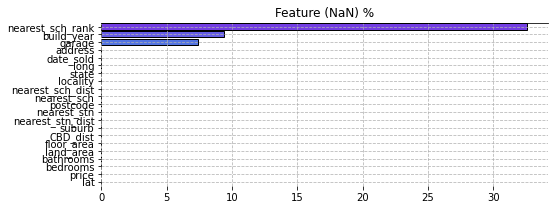

In [7]:
''' Remove Missing Data '''
transformer(show_nan=True,figsize=(8,3),title='Feature (NaN) %').transform(X=df_H)

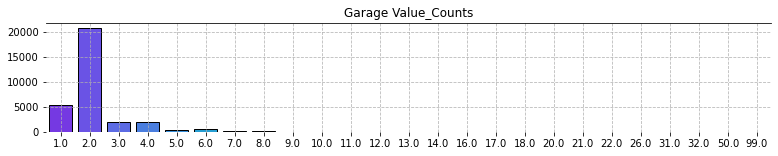

In [8]:
transformer(show_counts=True,title='Garage Value_Counts',figsize=(13,2)).transform(X=df_H['garage'])

Five of our features lack data: garage, which you should definitely set to zero, and build_year, which is a bit trickier.
It would be ideal to get this data rather than attempt to anticipate it via imputation, therefore let's discard the idea now.


In [9]:
print(df_H.shape)
df_H['garage'] = df_H['garage'].fillna(0)  # fill missing data with 0
df_H = transformer(drop_nan=True).transform(X=df_H)  # drop the rest

(33656, 21)
(20692, 21)


In [10]:
df_H.columns

Index(['address', 'suburb', 'price', 'bedrooms', 'bathrooms', 'garage',
       'land_area', 'floor_area', 'build_year', 'CBD_dist', 'nearest_stn',
       'nearest_stn_dist', 'date_sold', 'postcode', 'nearest_sch',
       'nearest_sch_dist', 'nearest_sch_rank', 'locality', 'state', 'long',
       'lat'],
      dtype='object')

In [11]:
# Split the features into categorical/ordinal features
df_num,df_cat = transformer(select_dtype=True).transform(X=df_H)

CATEGORICAL & ORDINAL FEATURES
Few categorical features to during.

Let's split the feature date_sold into two features; sold_month & sold_year.
suburb, nearest_stn are quite interesting features for which we can use mapping; we might consider introducing some form of scoring system & attempt to influence the model accuracy this way, mapping will be introduced in this models section.

In [12]:
df_cat.columns

Index(['address', 'suburb', 'nearest_stn', 'date_sold', 'nearest_sch',
       'locality', 'state'],
      dtype='object')

In [13]:
# df_perth3 = df_perth1.copy()
df_num[['sold_month', 'sold_year']] = df_cat['date_sold'].str.split('-', 1, expand=True).astype('float64')
df_cat.drop(['date_sold'],axis=1,inplace=True)

In [14]:
# df used for EDA
df_EDA = pd.concat([df_num,df_cat],axis=1)

In [15]:
df_EDA.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20692 entries, 1 to 33651
Data columns (total 22 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   price             20692 non-null  int64  
 1   bedrooms          20692 non-null  int64  
 2   bathrooms         20692 non-null  int64  
 3   garage            20692 non-null  float64
 4   land_area         20692 non-null  int64  
 5   floor_area        20692 non-null  int64  
 6   build_year        20692 non-null  float64
 7   CBD_dist          20692 non-null  int64  
 8   nearest_stn_dist  20692 non-null  int64  
 9   postcode          20692 non-null  int64  
 10  nearest_sch_dist  20692 non-null  float64
 11  nearest_sch_rank  20692 non-null  float64
 12  long              20692 non-null  float64
 13  lat               20692 non-null  float64
 14  sold_month        20692 non-null  float64
 15  sold_year         20692 non-null  float64
 16  address           20692 non-null  object

In [16]:
df_EDA.isna().sum()

price               0
bedrooms            0
bathrooms           0
garage              0
land_area           0
floor_area          0
build_year          0
CBD_dist            0
nearest_stn_dist    0
postcode            0
nearest_sch_dist    0
nearest_sch_rank    0
long                0
lat                 0
sold_month          0
sold_year           0
address             0
suburb              0
nearest_stn         0
nearest_sch         0
locality            0
state               0
dtype: int64


# Exploratory Data Analysis (EDA)

UNIVARIATE ANALYSES -EDA FEATURE DISTRIBUTIONS

One of a property's most crucial characteristics, along with the number of garages (vehicle spaces), is undoubtedly the number of bedrooms and bathrooms. Some observations:

We can see how rare one-bedroom apartments are in Perth (at least based on this information), with four-bedroom homes being the most prevalent, typically with one or two bathrooms and a garage with space for two cars.

Property sales have increased significantly during the past six years or so. Perth real estate brokers must be quite busy.
It is also possible to see a consistent rise in the number of houses constructed since the 1950s.
Even though it would make more sense to just remove them from some of the homes because they have so many garage spots, let's leave them for now.


In [17]:
def px_stats(df, n_cols=4, to_plot='box',height=800):
    
    ldf,_ = transformer(select_dtype=True).transform(X=df)
    numeric_cols = ldf.columns
    n_rows = -(-len(numeric_cols) // n_cols)  # math.ceil in a fast way, without import
    row_pos, col_pos = 1, 0
    fig = make_subplots(rows=n_rows, cols=n_cols,subplot_titles=numeric_cols.to_list())
    
    for col in numeric_cols:
        if(to_plot is 'histogram'):
            trace = go.Histogram(x=ldf[col],showlegend=False)
        else:
            trace = getattr(px, to_plot)(ldf[col],x=ldf[col])["data"][0]
            
        if col_pos == n_cols: 
            row_pos += 1
        col_pos = col_pos + 1 if (col_pos < n_cols) else 1
        fig.add_trace(trace, row=row_pos, col=col_pos)

    fig.update_layout(template='plotly_white');fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0})

#     if(to_plot is 'histogram'):
#         fig.update_traces(marker=dict(line=dict(width=1, color='white')))
    fig.update_layout(height=height);fig.show()

In [18]:
px_stats(df_EDA, to_plot='histogram')

DATA DISTRIBUTION BOXPLOTS

This time using boxplots; boxplots give a good indication of how the data is distributed & outliers in the data.
Whilst it is often stated that tree based, such as RF are not sensitive to outliers, such as this article on medium, it might be woth taking it into account, as there are good references that state otherwise as shown on stackexchange. So there is need to look into the effect of these outliers as well, when getting to the model generation stage.

In [19]:
px_stats(df_EDA, to_plot='box',height=400)


SUBURB SORTED PRICE RANGES

To visualise the statistics data of Price in different suburbs (sorted alphabetically), in a particular suburb it is quicker to find it by name when required.

There are a quite a number of property price cases which exceed the q1 & q3 threshold, even in different suburbs; which is an indicator that we have a number of 'outlier' cases.

Ideally we should be looking them, as they are likely going to complicate the fitting process for our models, especially if our features aren't chosen very well.


In [20]:
ldf = df_EDA.sort_values(by='suburb')
fig = px.box(ldf, x="suburb", y="price",template='plotly_white',
             title="Suburb Based Price Range (Alphabetically Arranged)",height=600)
fig.update_layout(yaxis={'categoryorder':'total ascending'},margin=dict(l=80, r=80, t=100, b=80))
fig.update_traces(marker=dict(size=4));fig.update_layout(xaxis=dict(rangeslider=dict(visible=True)));fig.show()

In [21]:
df_submed = df_EDA.groupby(['suburb']).median()
df_submin = df_EDA.groupby(['suburb']).min()
df_submax = df_EDA.groupby(['suburb']).max()

In [22]:
df_submed.head()

,price,bedrooms,bathrooms,garage,land_area,floor_area,build_year,CBD_dist,nearest_stn_dist,postcode,nearest_sch_dist,nearest_sch_rank,long,lat,sold_month,sold_year
suburb,,,,,,,,,,,,,,,,
Alexander Heights,440000.0,4.0,2.0,2.0,691.5,149.5,1989.5,13500.0,6950.0,6064.0,2.071051,46.0,115.849098,-31.835333,6.0,2018.0
Alfred Cove,805000.0,3.0,2.0,2.0,507.0,171.0,1996.0,10000.0,3900.0,6154.0,1.506975,61.0,115.825994,-32.040061,8.0,2016.0
Alkimos,390000.0,4.0,2.0,2.0,388.0,171.0,2014.0,40100.0,2000.0,6038.0,3.899459,39.0,115.723047,-32.289149,8.0,2019.0
Applecross,1365000.0,4.0,2.0,2.0,550.0,225.0,1994.0,7000.0,1800.0,6153.0,1.903017,34.0,115.837525,-32.024363,7.0,2018.0
Ardross,1032500.0,4.0,2.0,2.0,493.0,205.0,1999.0,8600.0,2400.0,6153.0,0.645277,34.0,115.837525,-32.024363,6.0,2017.0


 
SUBURB MEDIAN PROPERTY PRICES SORTED BY CBD_dist

Looking at the top 100 suburbs that are on average closest to the CBD, West Perth,Glendalough & Nollamara are amongst the 
cheaper alternatives, but we can can see a trend of higher property price, the closer to the the city centre we get as well.


In [23]:
dfx = df_submed.sort_values(by=['CBD_dist'],ascending=True)
fig = px.bar(dfx, x=dfx.index, y='price',template='plotly_white',text='CBD_dist',height=300)
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0});fig.show()

SUBURB MEDIAN PROPERTY PRICES SORTED BY nearest_stn_dist

We can look at which suburbs would be cheapest, if you wanted to live near public transport, Armadale, Parmelia, Warnbro among the cheaper suburbs overall.


In [24]:
dfx = df_EDA.groupby(['suburb']).median().sort_values(by=['nearest_stn_dist'],ascending=True)
fig = px.bar(dfx, x=dfx.index, y='price',template='plotly_white',hover_data=['nearest_stn_dist','price'],height=300)
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0});fig.show()


PROPERTY BUILD YEAR MIN/MED/MAX PROPERTY PRICES

Despite the market median house price being not exactly very low, hovering in the region of 400-500k in the last 60 years or so, there has tended to be properties that are "relatively affordable" built every year in the range 100-300k range, which is a positive thing, given the number people near the poverty line will only likely to increase as stated in the Canberra Times, (which likely is an indicator that more and more people will not be able to afford housing in general & is backed by an article from Melbourne Uni which states that many would-be first time buyers are priced out of the market).

Interesting to also note that nothing was built in 1944 (at least accoriding to this data) & there tends to be a common trend of median price reducing, the newer the property is in the dataset, a similar trend can be observed for the minimum price.


In [25]:
dfx = df_EDA.groupby(['build_year']).median().sort_values(by=['price'],ascending=True)
dfx2 = df_EDA.groupby(['build_year']).min().sort_values(by=['price'],ascending=True)
dfx3 = df_EDA.groupby(['build_year']).max().sort_values(by=['price'],ascending=True)

fig = go.Figure()
fig.add_trace(go.Bar(x=dfx3.index, y=dfx3['price'],name='max price',marker_color='rgb(38,38,49)'))
fig.add_trace(go.Bar(x=dfx.index, y=dfx['price'],name='median price',marker=dict(color='#0000FF')))
fig.add_trace(go.Bar(x=dfx2.index, y=dfx2['price'],name='lowest price',marker_color='#ee4026'))
fig.update_layout(barmode='overlay',template='plotly_white',height=300,title='Property Build Year Grouped House Prices')
fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0});fig.show()


FEATURE IMPORTANCES

To use various feature importance approaches including (SHAP values (with CatBoost), RandomForest() Feature Importance, XGB Feature Importance & KBest ) to get a quick idea of which features are quite influential in our models.

Interstingly enough, other feature importance methods also evaluated garage as a less impactful feature, we can see also see that long (longitudinal coodinates) is quite impactful in XGB & CAT models.


In [26]:

# Plot Relative Feature Importance
def feature_importance(tldf,feature='price',n_est=500):
    
    # X : Numerical / Object DataFrame
    ldf,ldf2 = transformer(select_dtype=True).transform(X=tldf)
     
    # Input dataframe containing feature & target variable
    X = ldf.copy()
    y = ldf[feature].copy()
    del X[feature]
    
#   CORRELATION
    imp = corrMat2(ldf,feature,figsize=(15,0.5),ret_id=True)
    del imp[feature]
    s1 = imp.squeeze(axis=0);s1 = abs(s1)
    s1.name = 'Correlation'
#     display(s1)
        
#   SHAP
    model = CatBoostRegressor(silent=True,n_estimators=n_est).fit(X,y)
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X)
    shap_sum = np.abs(shap_values).mean(axis=0)
    s2 = pd.Series(shap_sum,index=X.columns,name='Cat_SHAP').T
#     display(s2)
    
#   RANDOMFOREST
    model = RandomForestRegressor(n_est,random_state=0, n_jobs=-1)
    fit = model.fit(X,y)
    rf_fi = pd.DataFrame(model.feature_importances_,index=X.columns,
                                         columns=['RandForest']).sort_values('RandForest',ascending=False)
    s3 = rf_fi.T.squeeze(axis=0)
#     display(s3)

#   XGB 
    model=XGBRegressor(n_estimators=n_est,learning_rate=0.5,verbosity = 0)
    model.fit(X,y)
    data = model.feature_importances_
    s4 = pd.Series(data,index=X.columns,name='XGB').T
#     display(s4)
    
#   KBEST
    model = SelectKBest(k=X.shape[1], score_func=f_regression)
    fit = model.fit(X,y)
    data = fit.scores_
    s5 = pd.Series(data,index=X.columns,name='K_best')
#     display(s5)

    # Combine Scores
    df0 = pd.concat([s1,s2,s3,s4,s5],axis=1)
    df0.rename(columns={'target':'lin corr'})

    x = df0.values 
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    df = pd.DataFrame(x_scaled,index=df0.index,columns=df0.columns)
    df = df.rename_axis('Feature Importance via', axis=1)
    df = df.rename_axis('Feature', axis=0)
    
    pd.options.plotting.backend = "plotly"
    fig = df.plot(kind='bar',title='Scaled Feature Importance')
    fig.update_layout(template='plotly_white');fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0});fig.show()

In [27]:
feature_importance(df_EDA)

PEARSON CORRELATION

Linear correlation can be useful to understand how our variables change relative to one another in the input dataset, most feature related to price in an expected manner, perhaps most suprising out of the lot was land_area having a much smaller value than expected</code>, in compa


In [28]:
plotlyoff_corr(df_EDA.corr().round(2))


AREA FEATURE RELATIONS TO PRICE
Floor_area & Land_area have a relatively high feature importance as we saw previousy, let's look at the bivariate relations to price.


In [29]:
titles = ['Floor Area','Land Area']
fig = make_subplots(rows=1, cols=2,shared_yaxes=True,subplot_titles=titles,horizontal_spacing = 0.05)

fig.add_trace(go.Scattergl(y=df_EDA['price'].values,x=df_EDA['floor_area'].values,mode='markers',name='Floor Area',text=df_EDA.index,opacity=0.1),row=1, col=1)
fig.add_trace(go.Scattergl(y=df_EDA['price'].values,x=df_EDA['land_area'].values,mode='markers',name='Land Area',text=df_EDA.index,opacity=0.1),row=1, col=2)

fig.update_traces(marker=dict(size=4,line=dict(width=1.2,color='black')))
fig.update_layout(template='plotly_white',title='Area Feature Relation to Property Sold Price',height=500,showlegend=False)
fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0});fig.show()

We can see a very big difference between the two feature relations, when it comes to price value.
floor_area relation to price tends to be quite straightforward, whilst land area tends to be quite spread out.
If we actually zoom into land_area realation to price, we can note some lines at 10k, 20k & 40k, the relation as the correlation value suggests is quite spreadout and seemindly inconsistent, apart from these noted patterns.
Both relations contain a lot of outlier properties.
A good rule of thumb it to verify the data if possible, some things that can be noted:

60 Semerwater Crescent which has a value of 365k is likely an error according to realestate
Similarly; 12 Gailey Way on reiwa
Similarly; 3 Longstaff Avenue on reiwa
1264 Chittering Road (554,500m^2) on reiwa is probably an indicator anything below would probably be genuine, even though different sources do vary the value a little.
Of course, many realistic datasets require a thorough investigation, which is unfortunately quite a labourious task, so I'll limit my efforts here.

df_EDA[(df_EDA.index == '60 Semerwater Crescent') 
         | (df_EDA.index == '12 Gailey Way') 
         | (df_EDA.index == '3 Longstaff Avenue')
         | (df_EDA.index == '11 Semerwater Crescent')] 

In [30]:
df_EDA.loc['60 Semerwater Crescent','land_area'] = 375 # m^2
df_EDA.loc['12 Gailey Way','land_area'] = 375
df_EDA.loc['3 Longstaff Avenue','land_area'] = 574 
df_EDA.loc['11 Semerwater Crescent','land_area'] = 375 # m^2

land_area is one of the features that contains quite a large number of outliers. For smaller land_area proprties, this feature might not be the most impactful since they are all very similar, however the land area value does increase quite exponentially, thus it should be impactful only for a specific subset of properties, let's take a look at two subset groups.
Somewhere after the region of 1100-1300 (m^2), the values start to very rapidly increase, so lets make a division somewhere there.

In [31]:
df_EDA_smlland = df_EDA[df_EDA['land_area'] < 1200].copy()
df_EDA_bigland = df_EDA[(df_EDA['land_area'] >= 1200)].copy()

titles = ['Land_Area < 1200','Land_Area > 1000 | Land_Area < 30000']
fig = make_subplots(rows=1, cols=2,shared_yaxes=True,subplot_titles=titles,horizontal_spacing = 0.05)

fig.add_trace(go.Scattergl(y=df_EDA_smlland['price'],x=df_EDA_smlland['land_area'],mode='markers',name='Land Area',text=df_EDA_smlland.index,opacity=0.05),row=1, col=1)
fig.add_trace(go.Scattergl(y=df_EDA_bigland['price'],x=df_EDA_bigland['land_area'],mode='markers',name='Land Area',text=df_EDA_bigland.index,opacity=0.05),row=1, col=2)

fig.update_traces(marker=dict(size=4,line=dict(width=1.2,color='black')))
fig.update_layout(template='plotly_white',title='Land Area Subset Data',height=500,showlegend=False)
fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0});fig.show()

We can note that for smaller land_value properties and for larger ones, we have quite a different set of feature that are more impactful.
Whilst Perth may not be the most concentrated city when it comes to area values/population near the CBD (compared to other cities in general), there certainly is a difference between a property that are used only for building a house on & properties that allow one to build cottages, farms and alike. It may be beneficial to classify these properties, with the addition of a categorical feature that would define the property type.
Let's also create models for these two property types separately in the models section.

In [33]:
feature_importance(df_EDA_bigland)

DISTANCE FEATURE RELATION TO PROPERTY PRICE

CBD_dist as we saw above, has a significant weight according to the feature importance, however nearest_stn_dist is slightly less impactful, let's view the scatter relation.

Distance based features usually are very informative for models, let's take a look at two related features here (CBD_dist & nearest_stn_dist)

Lowering the opacity of the scatter data, we can get a sense of the general trend of increasing price as the CBD_dist reduces, with an accute increase very close to the CBD.

nearest_stn_dist, on the other hand is slightly more scatted, showing no visible linear relation in the scater data, however there tends to be a two direction scatter realation in addition to the central scatter region.


titles= ['CBD_dist','nearest_stn_dist']
fig = make_subplots(rows=1, cols=2,shared_yaxes=True,subplot_titles=titles,horizontal_spacing = 0.05)

fig.add_trace(go.Scattergl(y=df_EDA['price'],x=df_EDA['CBD_dist'],mode='markers',name='CBD_dist',text=df_EDA.index,opacity=0.05),row=1, col=1)
fig.add_trace(go.Scattergl(y=df_EDA['price'],x=df_EDA['nearest_stn_dist'],mode='markers',name='nearest_stn_dist',text=df_EDA.index,opacity=0.05),row=1, col=2)

fig.update_traces(marker=dict(size=3,line=dict(width=1.2,color='black')))
fig.update_layout(template='plotly_white',barmode='stack',title='Distance Feature Relations to Price',height=500,showlegend=False)
fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0});fig.show()

GEOSPATIAL DATA EXPLORATION (GDE)

In this dataset, we have each individual address as our index, but don't have the individual GPS coordinates.
Let's look at suburb based data instead using Choropeth Maps, some examples of how to create them shown in notebook; Australian Geographic Data Plots.
We'll use the General District Area datafile for Western Australia, where Perth is located. The geographic data is available in this source data.gov.

GDE - ENTIRE DATASET
Let's take a look at the suburb based median data, price, floor_area, land_area, nearest_stn_dist & build_year. Noting


In [35]:
import geopandas as gpd

In [36]:
from shapely.geometry import point, Polygon
%matplotlib inline

In [37]:
wa_gdf = gpd.read_file('Downloads/wa_localities/wa_localities.shp')

In [38]:
wa_gdf.head(3)


,LC_PLY_PID,LOC_PID,DT_CREATE,LOC_NAME,LOC_CLASS,STATE,geometry
0,lcpf44170854f77,loc3bf2f925e00a,2021-12-03,Abba River,Gazetted Locality,WA,"POLYGON ((115.53339 -33.69906, 115.53340 -33.6..."
1,lcp7b8e01870e5e,loc5e5235ca2ba7,2021-09-08,Abbey,Gazetted Locality,WA,"POLYGON ((115.26529 -33.66074, 115.26529 -33.6..."
2,lcp6332b7b953ab,loc87ace0ff193a,2021-12-03,Acton Park,Gazetted Locality,WA,"POLYGON ((115.36382 -33.74549, 115.36905 -33.7..."


In [39]:
def plot_geo(ldf,feature,title=None,lst_val=None):
    
    # Load Geometry File
    wa_gdf = gpd.read_file('Downloads/wa_localities/wa_localities.shp')    # Load the data using 
    wa_gdf.drop(['LC_PLY_PID','LOC_PID','DT_CREATE','LOC_NAME','LOC_CLASS','STATE','LOC_PID'],axis=1,inplace=True)

    wa_gdf.index = wa_gdf
    median_price = ldf.groupby(['suburb']).median()
    median_price.index = median_price.index.str.upper()
    df_merged = wa_gdf.join(median_price).dropna() 
    # some perth suburbs don't have data & drop other WA region suburbs to speed up map load

    # Convert geometry to GeoJSON
    df_merged = df_merged.to_crs(epsg=4327)
    lga_json = df_merged.__geo_interface__

    MAPBOX_ACCESSTOKEN = 'pk.eyJ1Ijoic2h0cmF1c3NhcnQiLCJhIjoiY2t0eXhzdGFpMWlscTJ1cDg3ZGhocmptayJ9.7TepS9eN6iKXwYjPHu44Tg'

    if(lst_val is None):
        lst_val = [df_merged[feature].min(),df_merged[feature].max()]

    # Set the data for the map
    data = go.Choroplethmapbox(geojson = lga_json,
                               locations = df_merged.index,    
                               z = df_merged[feature], 
                               text = title,
                               colorbar=dict(thickness=20, ticklen=3,outlinewidth=0),
                               marker_line_width=1, marker_opacity=0.8, colorscale="viridis",
                               zmin=lst_val[0], zmax=lst_val[1])

    layout = go.Layout(mapbox1 = dict(domain = {'x': [0, 1],'y': [0, 1]},center = dict(lat=-31.95, lon=115.8),
                       accesstoken = MAPBOX_ACCESSTOKEN,zoom = 9),
                       autosize=True,height=650)

    # Generate the map
    fig=go.Figure(data=data, layout=layout)
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()


GEOSPATIAL DATA EXPLORATION (GDE)

In this dataset, we have each individual address as our index, but don't have the individual GPS coordinates.
Let's look at suburb based data instead using Choropeth Maps, some examples of how to create them shown in notebook; Australian Geographic Data Plots.

We'll use the General District Area datafile for Western Australia, where Perth is located. The geographic data is available in this source data.gov.

GDE - ENTIRE DATASET
Let's take a look at the suburb based median data, price, floor_area, land_area, nearest_stn_dist & build_year. Noting

plot_geo(ldf=df_EDA,feature='price',title='Median House Price')
plot_geo(ldf=df_EDA,feature='floor_area',title='Median Floor Area',lst_val=[0,250])
plot_geo(ldf=df_EDA,feature='land_area',title='Median Land Area',lst_val=[0,1000])
plot_geo(ldf=df_EDA,feature='build_year',title='Median Build Year')
plot_geo(ldf=df_EDA,feature='nearest_stn_dist',title='Median Nearest Station Distance',lst_val=[0,10000])

GDE - LOWER PRICE PROPERTIES : ALL built_year

This dataset includes around 4.5k properties that cost less than 350,000 AUD at time of purchase.
This includes properties sold a while back as well, and is not necessarily a reflection of "current market price values", which is likely to have changed over time.

This is a significant issue that can affect the model accuracy, since some of our price data is "frozen in time", and we need features that can correct for this on top of some more obvious features like floor_area.

As an example, 10 Mardja Loop , a 5 bedroom house was apparently sold for 87k in 2003 ( not too long after the suburb was officially formed ), realestate attemps to evaluate the property in the current market by comparing it to similarly sized houses & suburb based sales. ie. somewhere in the region of perhaps 500k... So there would potentially be a significant shift in price, if the property was to be sold now.

We now should have a clear indication that our model, if trained on the curret set of data, will be predicting the property 'price' based on the evolution of sales data, in case that wasn't already clear.


In [40]:
df_EDA_low = df_EDA[df_EDA['price']<350000]
df_EDA_low.shape

(2465, 22)

We can see that a lot housing in this area was sold before being built, which is a common way to buy more affordable housing, usully associated with early sales before prices hikes, backed up by this article. It's also a nice way to increase the value of the property very early on if the construction projects are sucessfull. We can see some smart owners got a sizable return on their investment within a short period of time; 18 Mardja Loop, as an example.
We can see that if there is a need to build affordble housing, the cost associated with building quite a sizable house actually is not very high at all, as we can see some built in 2005. The question these days really is why would a contractor sell a house and not attempt to cash in, since the buyer most likely will be able to. Only at a government level is this issue tackleable (which it can if it really wanted to), as we can see the Australian Government does attempt to address home ownership rights in general; reference.

plot_geo(ldf=df_EDA_low,feature='price',title='Median House Price')

GDE - LOWER PRICE PROPERTIES : build_year >= 2015

Let's look at properties which were built after 2014 (over a period of three years here), it's actually quite interesting to know if low cost properties are actually available these days in Perth. We saw roughly 10 years earlier, it was quite possible, what about more recently?
So, over a period of a several years, 338 properties that are more or less affordable were built. Is that enough? Defnitely an intersting question to explore ...
Most of them are located north and south of Perth & some further to the east of Perth & the Indian Ocean, tough nuggies to those wanting to live by the ocean in close proximity central Perth. Waikiki , Alkimos, Jindalee, Eglinton are among some suburbs with relatively affordable property prices.
Just some intersting propeties that caught my attention:

1A Forster Avenue, which was sold at a very big loss.
1 Eastfield Count, which was originally built in 1997, rebuilt in 2017 via, once again sold before being rebuilt, and not being too far form the CBD.
101 Pine Crest Way, which was sold much earlier, and perhaps only had a property built more recently.


In [41]:
df_EDA_low2 = df_EDA[(df_EDA['price']<350000) & (df_EDA['build_year'] >= 2010)]
df_EDA_low2.shape

(453, 22)

In [42]:
df_EDA_low2[df_EDA_low2['suburb']=='Westminster'].sort_values(by='price')

,price,bedrooms,bathrooms,garage,land_area,floor_area,build_year,CBD_dist,nearest_stn_dist,postcode,...,long,lat,sold_month,sold_year,address,suburb,nearest_stn,nearest_sch,locality,state
20492,150000.0,3.0,2.0,2.0,210.0,109.0,2016.0,10000.0,4000.0,6061.0,...,115.843478,-31.864113,2.0,2017.0,3B Shelbred Way,Westminster,Stirling Station,BALCATTA SENIOR HIGH SCHOOL,BALGA,WA
5144,320000.0,3.0,2.0,2.0,237.0,165.0,2011.0,9200.0,3700.0,6061.0,...,115.843478,-31.864113,3.0,2018.0,13b Kurda Road,Westminster,Stirling Station,BALCATTA SENIOR HIGH SCHOOL,BALGA,WA
23217,349000.0,3.0,2.0,2.0,839.0,116.0,2010.0,9800.0,3900.0,6061.0,...,115.843478,-31.864113,4.0,2020.0,46C Balcombe Way,Westminster,Stirling Station,BALCATTA SENIOR HIGH SCHOOL,BALGA,WA


plot_geo(ldf=df_EDA_low2,feature='price',title='Median House Price')

EDA - PRESOLD PROPERTIES

We saw that in early 2000s, some properties were constantly being built and purchased at a very affordable price, as a result of prepurchasing the property before it was built (Presold Homes)
Preselling, generally is a way that allows buyers to purchase properties at more reasonable prices, especially with early upfront payments.

This practice was still noted to exist more recently as well. Let's take a look at a year by year basis, see how many properties were sold before they were built.

We can note that only 633 properties out of 30000 were prebuilt, which is not quite a lot. More importantly, they are probably acting like outliers having been sold under "market value" prices.

As the data shows, this kind of practice didn't really exist in Perth before 2000. 2013 & 2014 being the busiest years.


In [43]:
# Let's add to df_perth3
df_EDA_presold = df_EDA.copy()
df_EDA_presold['presold'] = df_EDA_presold['sold_year'].fillna(0) < df_EDA_presold['build_year']
df_EDA_presold['presold'].value_counts()

False    20367
True       329
Name: presold, dtype: int64

We can that after 2014, there was a sudden drop in prebuilt properties. Our data also seems to be lacking properties built after 2016, despite containing sold data.

It might also be interesting to create separate models for prebuilt & non prebuilt properties on top of a general model, as they tend to be in a category of their own.

In [44]:
dfx = df_EDA_presold.groupby(['sold_year']).sum()

fig = go.Figure()
fig.add_trace(go.Bar(x=dfx.index, y=dfx['presold'],name='Presold Properties by Year'))
fig.update_layout(barmode='overlay',template='plotly_white',height=300,title='Presold Properties by Year')
fig.update_layout(margin={"r":0,"t":60,"l":0,"b":0});fig.show()

Comparing presold properties to non presold, through a scatter matrix, we can generally get an idea they don't tend be very different when it comes to basic features like bedrooms,bathrooms,land_area & floor_area.
The prices of the current set of presold properties, on the otherhand are certainly on the lower end.

In [45]:
# Plot Scatter Matrix using Plotly Express
def scat_mat(ldf,dim=None,colour=None,hov_name=None,title=None):
    
    fig = px.scatter_matrix(ldf,dimensions=dim,opacity=0.5,color=colour,hover_name=hov_name,height=1000)
    fig.update_traces(marker=dict(size=6,line=dict(width=1,color='black')))
    fig.update_layout(template='plotly_white',title=title) # stack/overlay/group
    fig.show()

In [46]:
tlist = ['price','bedrooms','bathrooms','land_area','floor_area']
scat_mat(ldf=df_EDA_presold,dim=tlist,colour='presold',hov_name=df_EDA_presold.index,title='Presold Property Scatter Matrix Relations')

Let's also take a look where these properties were built; we can note that quite a lot of them are further away from Perth, and some probably even closer to Mandurah than Perth itself, and upon reviewing some properties, there it seems to be quite more affordable and in close proximity to the oceans.

plot_geo(ldf=df_EDA_presold[df_EDA_presold['presold']==True],feature='price',title='Presold Properties Median House Price')